<a href="https://colab.research.google.com/github/sakshikamal/yolov5/blob/master/Copy_of_Roboflow_Custom_YOLOv5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# How to Train YOLOv5 on Custom Objects

This tutorial is based on the [YOLOv5 repository](https://github.com/ultralytics/yolov5) by [Ultralytics](https://www.ultralytics.com/). This notebook shows training on **your own custom objects**. Many thanks to Ultralytics for putting this repository together - we hope that in combination with clean data management tools at Roboflow, this technologoy will become easily accessible to any developer wishing to use computer vision in their projects.

### Accompanying Blog Post

We recommend that you follow along in this notebook while reading the blog post on [how to train YOLOv5](https://blog.roboflow.ai/how-to-train-yolov5-on-a-custom-dataset/), concurrently.

### Steps Covered in this Tutorial

In this tutorial, we will walk through the steps required to train YOLOv5 on your custom objects. We use a [public blood cell detection dataset](https://public.roboflow.ai/object-detection/bccd), which is open source and free to use. You can also use this notebook on your own data.

To train our detector we take the following steps:

* Install YOLOv5 dependencies
* Download custom YOLOv5 object detection data
* Write our YOLOv5 Training configuration
* Run YOLOv5 training
* Evaluate YOLOv5 performance
* Visualize YOLOv5 training data
* Run YOLOv5 inference on test images
* Export saved YOLOv5 weights for future inference



### **About**

[Roboflow](https://roboflow.com) enables teams to deploy custom computer vision models quickly and accurately. Convert data from to annotation format, assess dataset health, preprocess, augment, and more. It's free for your first 1000 source images.

**Looking for a vision model available via API without hassle? Try Roboflow Train.**

![Roboflow Wordmark](https://i.imgur.com/dcLNMhV.png)



#Install Dependencies

_(Remember to choose GPU in Runtime if not already selected. Runtime --> Change Runtime Type --> Hardware accelerator --> GPU)_

In [6]:
%cd ..



/content


In [7]:
# clone YOLOv5 repository
!git clone https://github.com/sakshikamal/yolov5.git  # clone repo
%cd yolov5
#!git reset --hard 886f1c03d839575afecb059accf74296fad395b6

Cloning into 'yolov5'...
remote: Enumerating objects: 7158, done.
remote: Counting objects: 100% (27/27), done.
remote: Compressing objects: 100% (25/25), done.
remote: Total 7158 (delta 2), reused 18 (delta 0), pack-reused 7131
Receiving objects: 100% (7158/7158), 21.83 MiB | 16.96 MiB/s, done.
Resolving deltas: 100% (4899/4899), done.
/content/yolov5


In [8]:
# install dependencies as necessary
!pip install -qr requirements.txt  # install dependencies (ignore errors)
import torch

from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Setup complete. Using torch 1.9.0+cu102 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


# Download Correctly Formatted Custom Dataset 

We'll download our dataset from Roboflow. Use the "**YOLOv5 PyTorch**" export format. Note that the Ultralytics implementation calls for a YAML file defining where your training and test data is. The Roboflow export also writes this format for us.

To get your data into Roboflow, follow the [Getting Started Guide](https://blog.roboflow.ai/getting-started-with-roboflow/).

In [9]:
# Export code snippet and paste here
%cd /content
!curl -L "https://app.roboflow.com/ds/STqdN2LfE1?key=B9ZWVZgBy4" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   1706      0 --:--:-- --:--:-- --:--:--  1703
100  196M  100  196M    0     0  33.4M      0  0:00:05  0:00:05 --:--:-- 50.0M
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/1026_jpg.rf.ec334a881e426b59b8c5fc4cf7ddd6ff.jpg  
 extracting: test/images/1027_jpg.rf.6f747c595d3f89fb5fb9c33a70d8887a.jpg  
 extracting: test/images/1034_jpg.rf.ebe9af88b3e937b145ecdfd48004122d.jpg  
 extracting: test/images/1038_jpg.rf.592ce13e8ab8da9d14dc23951addda65.jpg  
 extracting: test/images/1043_jpg.rf.0e8a414ccb663bf9bff8facb1553f164.jpg  
 extracting: test/images/1057_jpg.rf.62578536d3a13be5e274fcdee7f96263.jpg  
 extracting: test/images/1063_jpg.rf.6f5ee4cf8977fd510d46d2229bba2aa4.jpg  

In [10]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat data.yaml

train: ../train/images
val: ../valid/images

nc: 8
names: ['battery', 'bulb', 'keyboard', 'laptop', 'mobile phone', 'monitor', 'mouse', 'phone']

# Define Model Configuration and Architecture

We will write a yaml script that defines the parameters for our model like the number of classes, anchors, and each layer.

You do not need to edit these cells, but you may.

In [ ]:
# define number of classes based on YAML
import yaml
with open("data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [12]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/yolov5s.yaml

# parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, C3, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C

In [13]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [14]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

# Train Custom YOLOv5 Detector

### Next, we'll fire off training!


Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive [folder](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J))
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [ ]:
#mounting google drive
from google.colab import drive

drive.mount(‘content/gdrive’)


SyntaxError: ignored

In [ ]:
# train yolov5s on custom data for 100 epochs
# time its performance
# %%tim
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 100 --data '../data.yaml' --cfg ./models/custom_yolov5s.yaml --weights '/content/drive/MyDrive/best.pt' --name yolov5s_results  --cache

/content/yolov5
Traceback (most recent call last):
  File "train.py", line 25, in <module>
  File "/content/yolov5/test.py", line 12, in <module>
    from models.experimental import attempt_load
  File "/content/yolov5/models/experimental.py", line 7, in <module>
    from models.common import Conv, DWConv
  File "/content/yolov5/models/common.py", line 15, in <module>
    from utils.datasets import letterbox
  File "/content/yolov5/utils/datasets.py", line 26, in <module>
    from utils.general import check_requirements, check_file, check_dataset, xyxy2xywh, xywh2xyxy, xywhn2xyxy, xyn2xy, \
  File "/content/yolov5/utils/general.py", line 24, in <module>
    import torchvision
  File "/usr/local/lib/python3.7/dist-packages/torchvision/__init__.py", line 7, in <module>
    from torchvision import datasets
  File "/usr/local/lib/python3.7/dist-packages/torchvision/datasets/__init__.py", line 2, in <module>
    from .folder import ImageFolder, DatasetFolder
  File "<frozen importlib._boots

# Evaluate Custom YOLOv5 Detector Performance

Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the **--name** flag when we train. In our case, we named this `yolov5s_results`. (If given no name, it defaults to `results.txt`.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`.

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

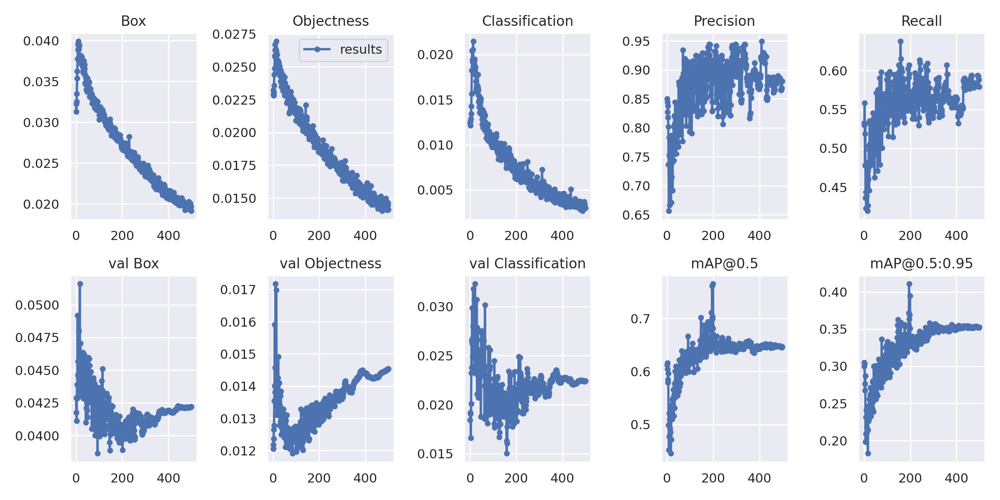

In [ ]:
2# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/yolov5/runs/train/yolov5s_results2/results.png', width=1000)  # view results.png

### Curious? Visualize Our Training Data with Labels

After training starts, view `train*.jpg` images to see training images, labels and augmentation effects.

Note a mosaic dataloader is used for training (shown below), a new dataloading concept developed by Glenn Jocher and first featured in [YOLOv4](https://arxiv.org/abs/2004.10934).

In [ ]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results2/test_batch0_labels.jpg', width=900)

GROUND TRUTH TRAINING DATA:


FileNotFoundError: ignored

GROUND TRUTH AUGMENTED TRAINING DATA:


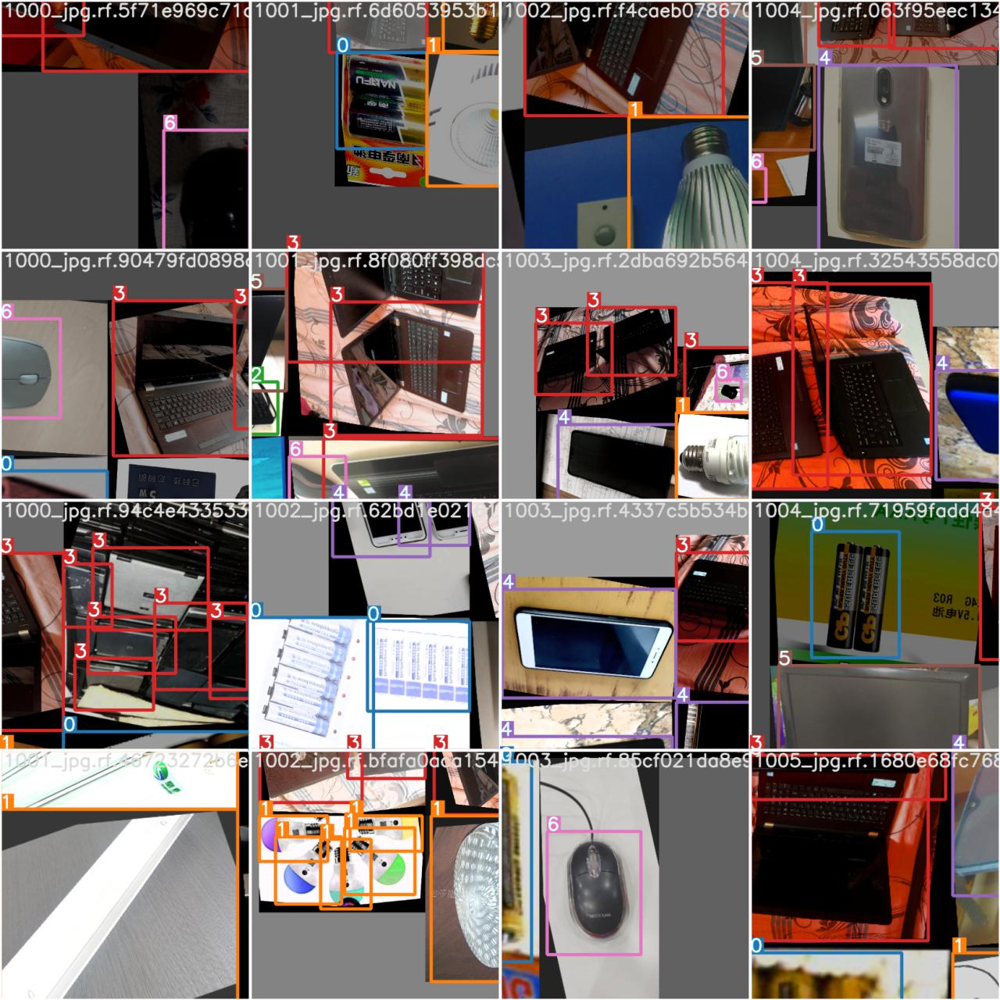

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results2/train_batch0.jpg', width=900)

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [ ]:
# trained weights are saved by default in our weights folder
%ls runs/

ls: cannot access 'runs/': No such file or directory


In [ ]:
%ls runs/train/yolov5s_results/weights

In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights /content/drive/MyDrive/best.pt --img 416 --conf 0.4 --source ../test/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, half=False, hide_conf=False, hide_labels=False, imgsz=416, iou_thres=0.45, line_thickness=3, max_det=1000, name='exp', nosave=False, project='runs/detect', save_conf=False, save_crop=False, save_txt=False, source='../test/images', update=False, view_img=False, weights=['/content/drive/MyDrive/best.pt'])
YOLOv5 🚀 v5.0-183-g381c80e torch 1.8.1+cu101 CUDA:0 (Tesla K80, 11441.1875MB)

Fusing layers... 
Model Summary: 232 layers, 7265397 parameters, 0 gradients
image 1/98 /content/yolov5/../test/images/1026_jpg.rf.ec334a881e426b59b8c5fc4cf7ddd6ff.jpg: 416x320 1 laptop, 2 mobile phones, Done. (0.023s)
image 2/98 /content/yolov5/../test/images/1027_jpg.rf.6f747c595d3f89fb5fb9c33a70d8887a.jpg: 320x416 1 laptop, 2 mobile phones, Done. (0.023s)
image 3/98 /content/yolov5/../test/images/1034_jpg.rf.ebe9af88b3e937b145ecdfd48004122d.jpg: 320x416 2 laptops, 2 mobile phones, Done. (0.

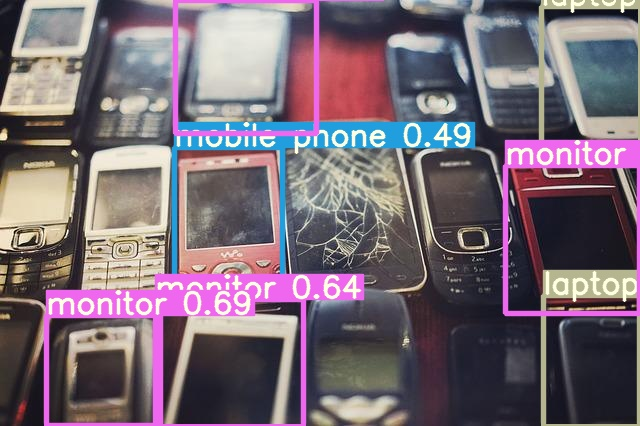

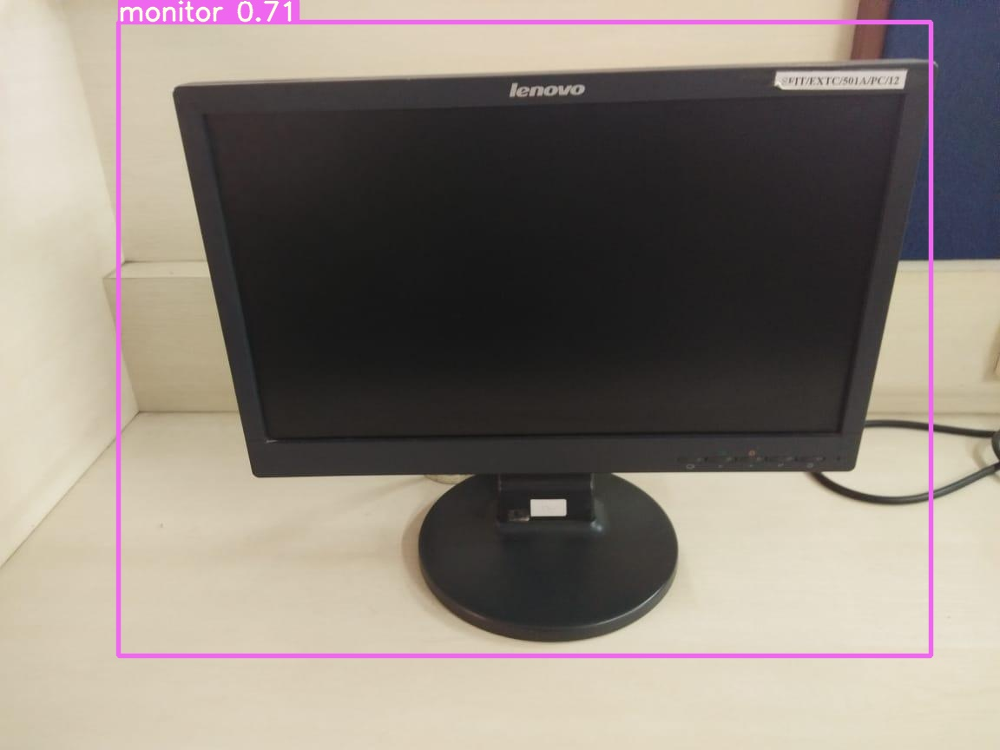

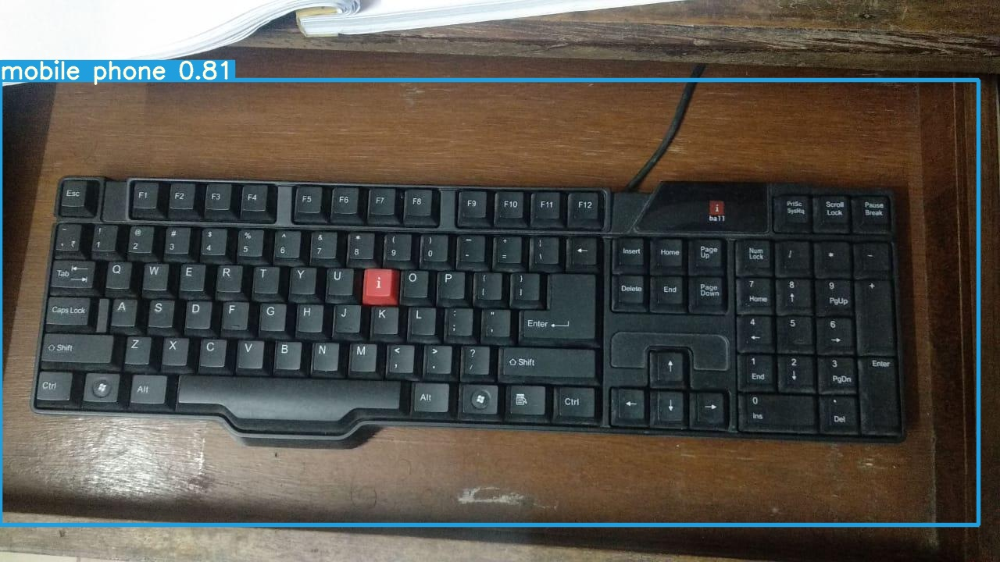

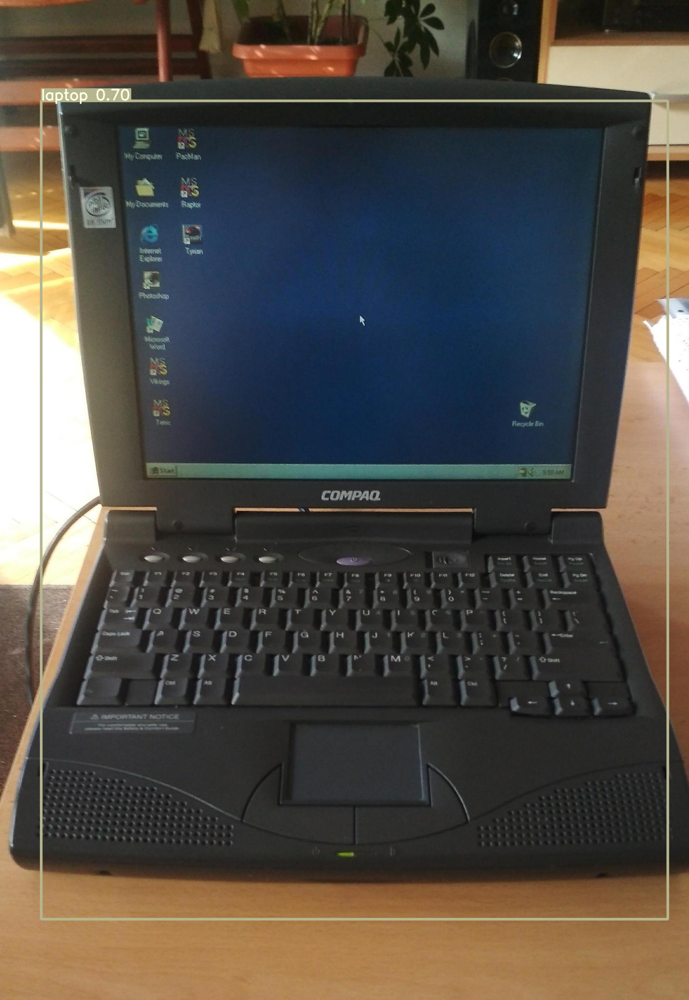

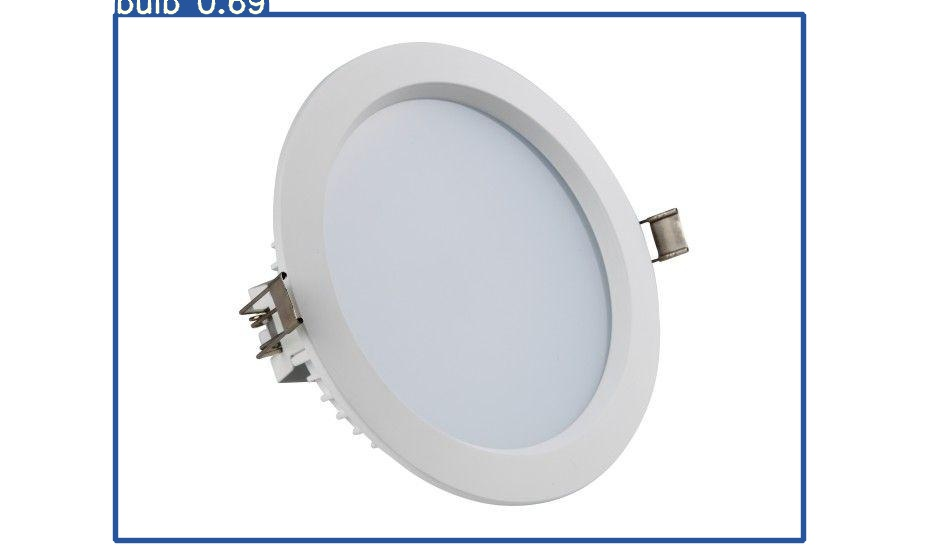

...

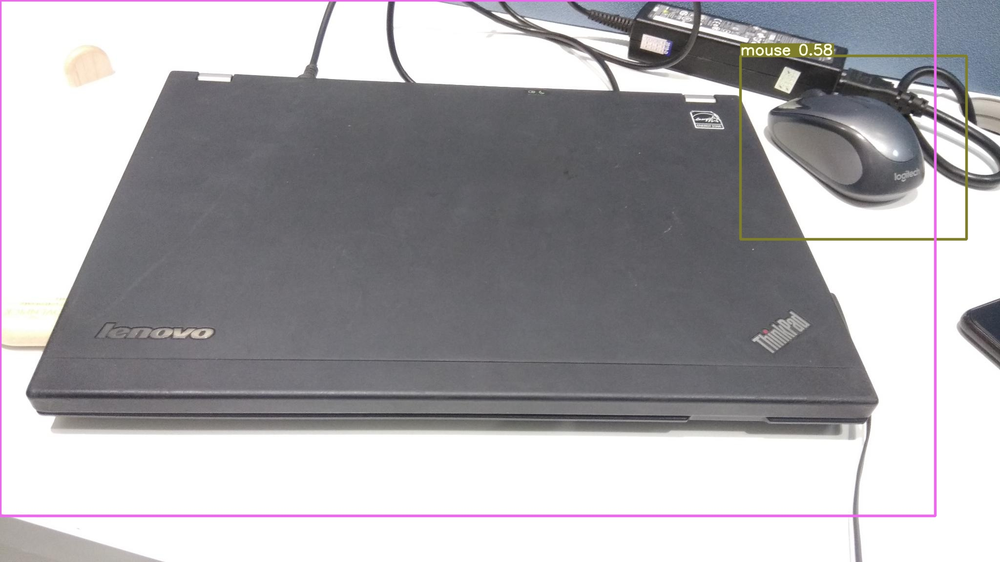

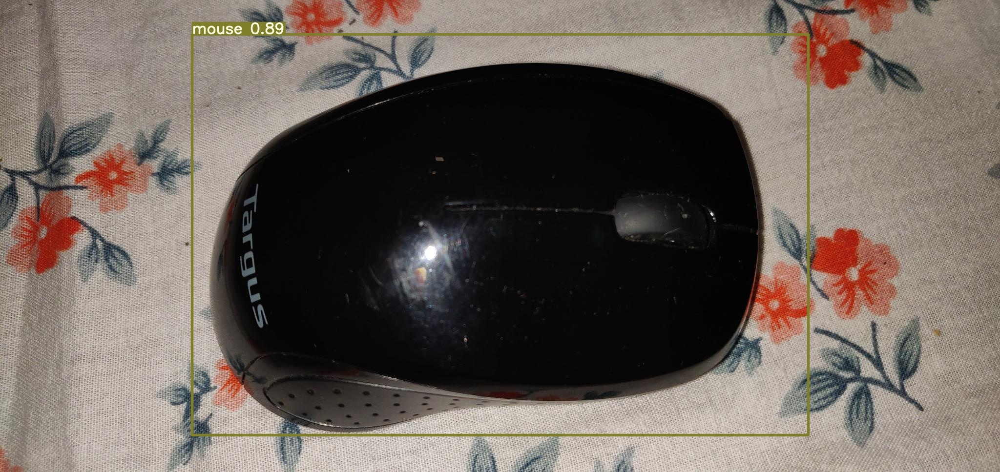

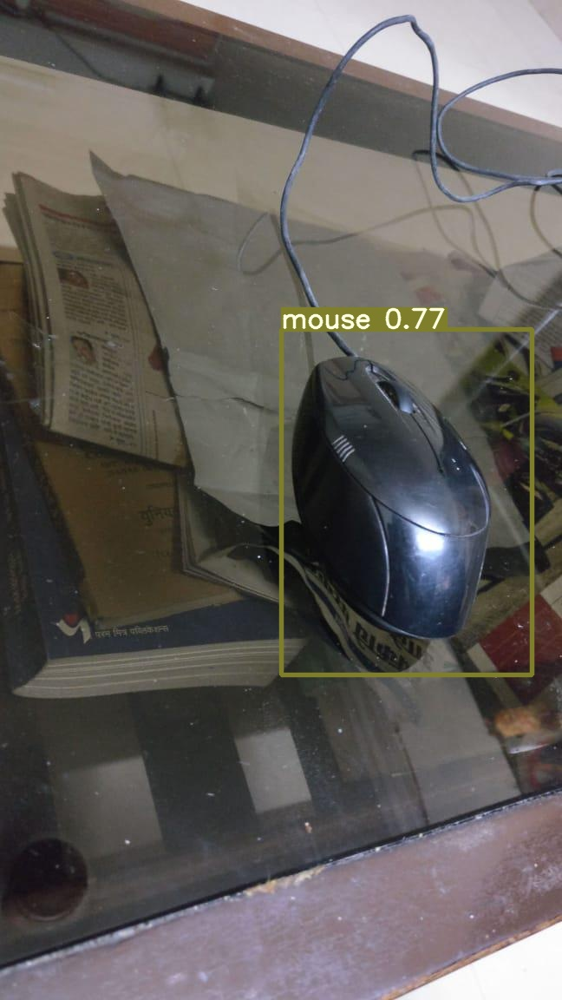

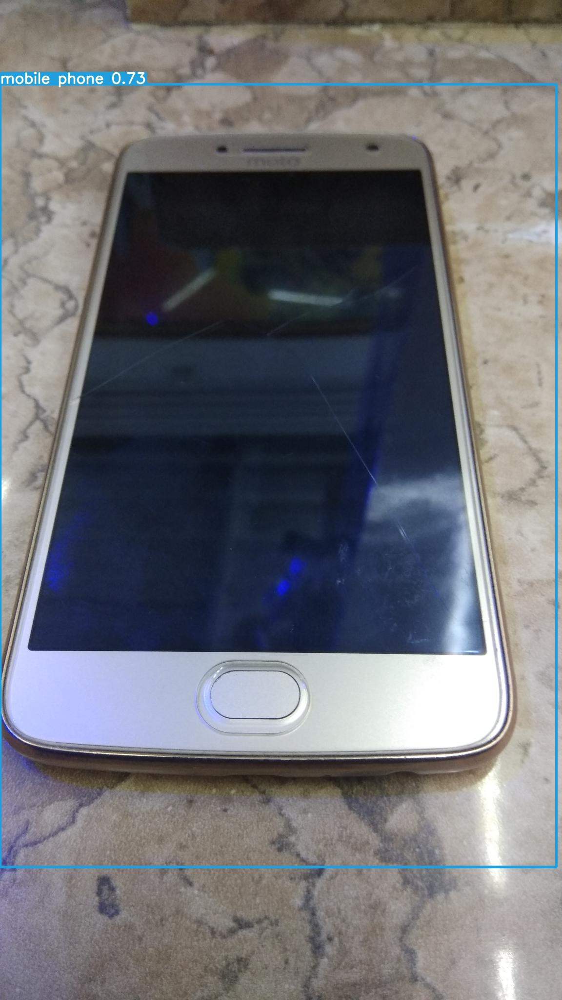

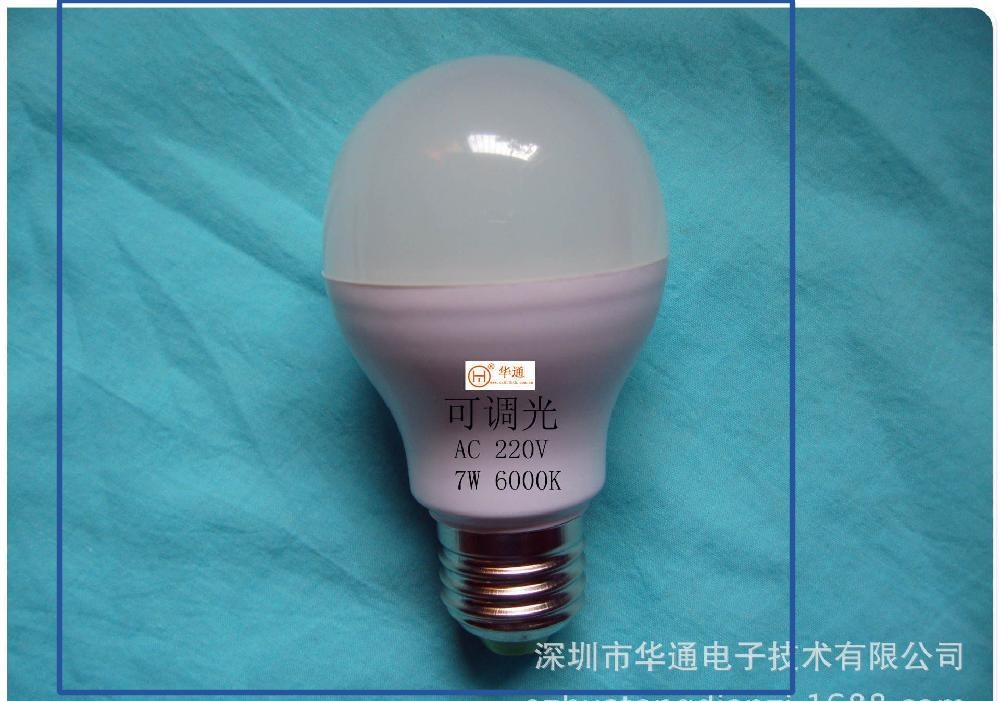

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Export Trained Weights for Future Inference

Now that you have trained your custom detector, you can export the trained weights you have made here for inference on your device elsewhere

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
%cp /content/yolov5/runs/train/yolov5s_results2/weights/best.pt /content/gdrive/My\ Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [20]:
!pip install flask-ngrok

In [ ]:
from __future__ import division, print_function
# coding=utf-8
import sys
import os
import glob
import re, glob, os,cv2
import numpy as np
import pandas as pd
from shutil import copyfile
import shutil
from distutils.dir_util import copy_tree

# Flask utils
from flask import Flask, redirect, url_for, request, render_template
from werkzeug.utils import secure_filename
#from gevent.pywsgi import WSGIServer

import detect

# Define a flask app
app = Flask(__name__)

#for f in os.listdir("static\\similar_images\\"):
#    os.remove("static\\similar_images\\"+f)

#print('Model loaded. Check http://127.0.0.1:5000/')
from flask_ngrok import run_with_ngrok
from flask import Flask

app=Flask(__name__)
run_with_ngrok(app)
app.config['UPLOAD_FOLDER']='/content/yolov5/uploads'
@app.route('/', methods=['GET'])
def index():
    # Main page
    return render_template('index.html')


@app.route('/predict', methods=['GET', 'POST'])
def upload():
    # if request.method == 'POST':
    #     # Get the file from post request
    #     f = request.files['file']

    #     # Save the file to ./uploads
    #     basepath = os.path.dirname(__file__)
    #     file_path = os.path.join(
    #         basepath, 'uploads', secure_filename(f.filename))
    #     f.save(file_path)
    #     flash(file_path)
    if request.method == 'POST':
        # check if the post request has the file part
        if 'file' not in request.files:
            flash('No file part')
            return redirect(request.url)
        file = request.files['file']
        # if user does not select file, browser also
        # submit a empty part without filename
        if file.filename == '':
            flash('No selected file')
            return redirect(request.url)
        
        filename = secure_filename(file.filename)
        file_path=os.path.join(app.config['UPLOAD_FOLDER'], filename)
        file.save(os.path.join(app.config['UPLOAD_FOLDER'], filename))

        # Make prediction
        #similar_glass_details=glass_detection.getUrl(file_path)
        return detect.detect(weights='/content/drive/MyDrive/best.pt', source=file_path, view_img=True,project='/content/yolov5/runs/detect', save_txt=True)

    return render_template('upload.html')

if __name__ == '__main__':
    app.run()





 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: off


 * Running on http://127.0.0.1:5000/ (Press CTRL+C to quit)


 * Running on http://2eaae9c4a898.ngrok.io
 * Traffic stats available on http://127.0.0.1:4040


In [19]:
%ls


app.py     Dockerfile   LICENSE     requirements.txt*  test.py         uploads/
data/      hubconf.py   models/     static/            train.py        utils/
detect.py  __init__.py  README.md*  templates/         tutorial.ipynb  weights/


In [18]:
%cd yolov5/



[Errno 2] No such file or directory: 'yolov5/'
/content/yolov5


In [33]:
!python app.py


 * Serving Flask app "app" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: off
 * Running on http://127.0.0.1:5000/ (Press CTRL+C to quit)
 * Running on http://cf7392fd1f9b.ngrok.io
 * Traffic stats available on http://127.0.0.1:4040
127.0.0.1 - - [01/Jul/2021 21:06:47] "GET / HTTP/1.1" 200 -
127.0.0.1 - - [01/Jul/2021 21:06:48] "GET /static/css/bootstrap.min.css HTTP/1.1" 200 -
127.0.0.1 - - [01/Jul/2021 21:06:48] "GET /static/css/style.css HTTP/1.1" 200 -
127.0.0.1 - - [01/Jul/2021 21:06:48] "GET /static/js/jquery.min.js HTTP/1.1" 200 -
127.0.0.1 - - [01/Jul/2021 21:06:48] "GET /static/css/animate.css HTTP/1.1" 200 -
127.0.0.1 - - [01/Jul/2021 21:06:48] "GET /static/js/modernizr-3.5.0.min.js HTTP/1.1" 200 -
127.0.0.1 - - [01/Jul/2021 21:06:48] "GET /static/js/main.js HTTP/1.1" 200 -
127.0.0.1 - - [01/Jul/2021 21:06:48] "GET /static/js/bootstrap.min.js HTTP/1.1" 200 -
127.0.0.1 - - [01/Jul/2021 21:06:48] "GET /static/js/fontawesome.js 

In [34]:
!git add .

In [37]:
!git commit -m "new changes for csv"

[master 2dead40] new changes for csv
 5 files changed, 61 insertions(+), 9 deletions(-)
 create mode 100644 560062.csv
 create mode 100644 models/custom_yolov5s.yaml
 create mode 100644 nameList.csv


In [40]:
!git remote -v


origin	https://github.com/sakshikamal/yolov5.git (fetch)
origin	https://github.com/sakshikamal/yolov5.git (push)


In [42]:
!git push

fatal: could not read Username for 'https://github.com': No such device or address


In [39]:
!git config --global user.email "sakshikamal99@gmail.com"
!git config --global user.name "sakshikamal"

In [ ]:
%ls



data.yaml  README.roboflow.txt  sample_data/  test/  train/  valid/  yolov5/


## Congrats!

Hope you enjoyed this!

--Team [Roboflow](https://roboflow.ai)